In [1]:
import os
import json
from utils import read_tables, plot_all_columns, plot_real_vs_synthetic_parent_child
import pandas as pd
from sdv.utils import display_tables
from sdv.evaluation import evaluate
from sdmetrics.reports.multi_table import QualityReport
from sdmetrics.reports import utils
from sdv import Metadata


In [2]:
real_data = read_tables(
    '../data/rossman_store_sales/source', split_by="_", name_index=0)
synthetic_data = read_tables(
    '../data/rossman_store_sales/synthetic_mostlyai', split_by="_", name_index=0)

c:\Users\valte\Faks\mag1\Project\Synthetic-data-generation-project\notebooks\utils.py:14: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  table = pd.read_csv(
c:\Users\valte\Faks\mag1\Project\Synthetic-data-generation-project\notebooks\utils.py:14: DtypeWarning: Columns (7) have mixed types. Specify dtype option on import or set low_memory=False.
  table = pd.read_csv(


In [3]:
del real_data['train']
del real_data['test']

In [4]:
# make all column names lowercase for all tables in real and synthetic data
for table_name, table in real_data.items():
    real_data[table_name].columns = [col.lower() for col in table.columns]
for table_name, table in synthetic_data.items():
    synthetic_data[table_name].columns = [col.lower() for col in table.columns]

# rename date column to sale_date for all tables in real and synthetic data
for table_name, table in real_data.items():
    real_data[table_name] = table.rename(columns={'date': 'sale_date'})
for table_name, table in synthetic_data.items():
    synthetic_data[table_name] = table.rename(columns={'date': 'sale_date'})

# add index column of 1 to n to sales table in real and synthetic data
for table_name, table in real_data.items():
    if table_name == 'sales':
        real_data[table_name]['index'] = range(1, len(table) + 1)

for table_name, table in synthetic_data.items():
    if table_name == 'sales':
        synthetic_data[table_name]['index'] = range(1, len(table) + 1)

In [6]:
metadata = Metadata()

In [7]:
# store_fields_metadata = {
#     'sale_date': {
#         'type': 'datetime',
#         'format': '%Y-%m-%d'
#     },
# }
metadata.add_table(
    name = 'store',
    data = real_data['store'],
    primary_key='store',
    # fields_metadata=store_fields_metadata,
)

In [8]:
sales_fields_metadata = {
    'sale_date': {
        'type': 'datetime',
        'format': '%Y-%m-%d'
    },
}
metadata.add_table(
    name = 'sales',
    data = real_data['sales'],
    primary_key='index',
    parent='store',
    foreign_key='store',
    fields_metadata=sales_fields_metadata,
)


In [9]:
metadata_name = '../models/rossman-sdv-1.0-metadata.json'
metadata.to_json(metadata_name)

In [10]:
metadata = Metadata(metadata_name)

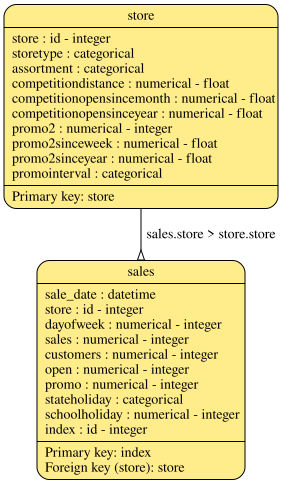

In [11]:
metadata.visualize()

In [12]:
display_tables(real_data)

In [13]:
real_data.keys()

dict_keys(['store', 'sales'])

In [14]:
synthetic_data.keys()

dict_keys(['sales', 'store'])

In [15]:
evaluate(
    synthetic_data,
    real_data,
    aggregate=False,
    metadata=metadata)

,metric,name,raw_score,normalized_score,min_value,max_value,goal,error
0,KSComplement,Inverted Kolmogorov-Smirnov D statistic,0.955836,0.955836,0.0,1.0,MAXIMIZE,None
1,CSTest,Chi-Squared,0.999025,0.999025,0.0,1.0,MAXIMIZE,None


In [16]:
with open(metadata_name) as metadata_file:
    metadata = json.load(metadata_file)
report = QualityReport()
report.generate(real_data, synthetic_data, metadata)

Creating report:  40%|████      | 2/5 [00:03<00:04,  1.51s/it]/Users/martinjurkovic/.pyenv/versions/3.8.12/envs/ds_project/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
/Users/martinjurkovic/.pyenv/versions/3.8.12/envs/ds_project/lib/python3.8/site-packages/scipy/stats/_stats_py.py:4424: ConstantInputWarning: An input array is constant; the correlation coefficient is not defined.
  warnings.warn(stats.ConstantInputWarning(msg))
Creating report: 100%|██████████| 5/5 [00:07<00:00,  1.46s/it]



Overall Quality Score: 94.65%

Properties:
Column Shapes: 95.4%
Column Pair Trends: 94.38%
Parent Child Relationships: 94.17%


In [17]:
report.get_details(
    property_name='Column Shapes',
    table_name='store')

,Table,Column,Metric,Quality Score
0,store,competitiondistance,KSComplement,0.967311
1,store,competitionopensincemonth,KSComplement,0.972989
2,store,competitionopensinceyear,KSComplement,0.973724
3,store,promo2,KSComplement,0.982960
4,store,promo2sinceweek,KSComplement,0.962103
5,store,promo2sinceyear,KSComplement,0.977108
6,store,storetype,TVComplement,0.973094
7,store,assortment,TVComplement,0.981166
8,store,promointerval,TVComplement,0.968046


In [18]:
fig = report.get_visualization(
    property_name='Column Shapes',
    table_name='store')

fig.show()

In [26]:
fig = report.get_visualization(
    property_name='Column Pair Trends',
    table_name='store')

fig.show()

In [27]:
fig = report.get_visualization(
    property_name='Column Shapes',
    table_name='sales')

fig.show()

In [28]:
fig = report.get_visualization(
    property_name='Column Pair Trends',
    table_name='sales')

fig.show()

In [29]:
fig = report.get_visualization(
    property_name='Parent Child Relationships')

fig.show()

In [19]:
plot_all_columns(real_data, synthetic_data, metadata)

Could not plot store.store
sdtype of type 'id' not recognized.


Could not plot sales.store
sdtype of type 'id' not recognized.


Could not plot sales.index
sdtype of type 'id' not recognized.


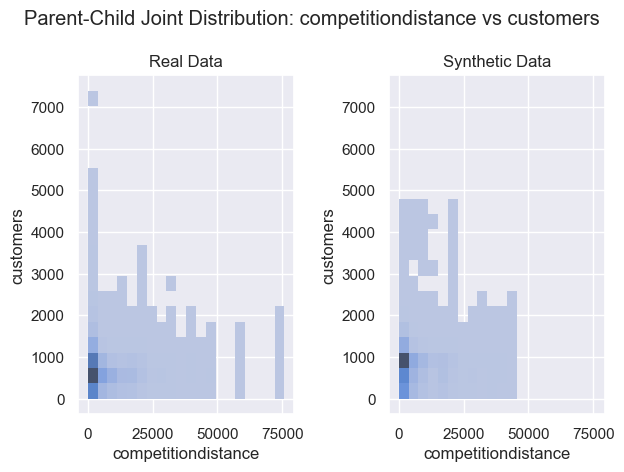

In [5]:
col_parent = 'competitiondistance'
col_child = 'customers'
plot_real_vs_synthetic_parent_child(real_data, synthetic_data, 'store', 'sales', col_parent, col_child, kind='hist', samp_size=1)